In [1]:
from IPython.display import Audio
import numpy as np
import matplotlib.pyplot as plt
import librosa
import os
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader, Dataset, random_split
from torchsummary import summary
from preprocessing.save_npz import save_stft
from preprocessing.data import DSD100, dataloader, data_split
from model.network import UNet
from model.train_model import train

In [29]:
song_path = "data/DSD100/mixtures/train/013 - Detsky Sad - Walkie Talkie/mixture.wav"
# Load song
audio_arr, sr = librosa.load(song_path, sr=8192)
audio_arr.shape

(1560430,)

In [30]:
# Audio play
Audio(audio_arr, rate=sr)

In [31]:
audio_stft = librosa.stft(audio_arr, n_fft=1024, hop_length=768)
audio_stft.shape

(513, 2032)

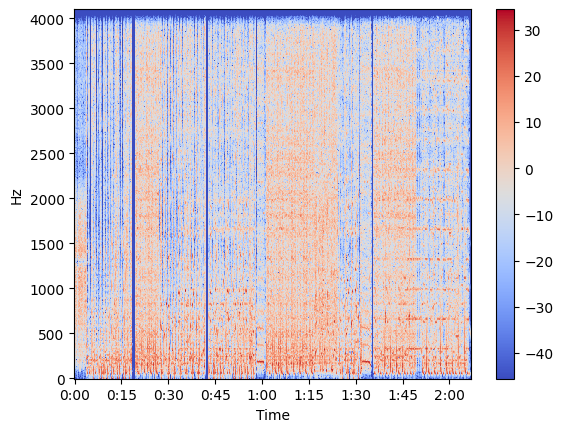

In [32]:
audio_stft_db = librosa.amplitude_to_db(np.abs(audio_stft))
librosa.display.specshow(audio_stft_db, sr=sr, x_axis="time", y_axis="hz")
plt.colorbar()
plt.show()

In [33]:
# Normalize STFT between [0,1]
audio_stft = (np.abs(audio_stft) - np.min(np.abs(audio_stft))) / (
    np.max(np.abs(audio_stft)) - np.min(np.abs(audio_stft))
)

In [34]:
# Select STFT of size (512, 128)
audio = librosa.istft(audio_stft[:, :128], hop_length=768, n_fft=1024)
audio_stft[:, :128].shape

(513, 128)

In [49]:
%find ./data -name '.DS_Store' -type f -delete

UsageError: Line magic function `%find` not found.


In [55]:
# Convert to spectrogram and save in .npz file
dataset_path = "data/DSD100"

mixture_path = dataset_path + "/" + sorted(os.listdir(dataset_path))[0]
sources_path = dataset_path + "/" + sorted(os.listdir(dataset_path))[1]

train_path = sources_path + "/" + sorted(os.listdir(mixture_path))[0]
val_path = sources_path + "/" + sorted(os.listdir(mixture_path))[1]

sorted(os.listdir(sources_path))

['train', 'val']

In [57]:
song_name = sorted(os.listdir(train_path))[0]
song_path = train_path + "/" + song_name

song_path

'data/DSD100/sources/train/001 - AM Contra - Heart Peripheral'

In [45]:
sorted(os.listdir(song_path))

['bass.wav', 'drums.wav', 'other.wav', 'vocals.wav']

In [66]:
dataset_path = "data/DSD100"
save_path = "data/DSD100_spectrogram"

save_stft(dataset_path, save_path)

001 - AM Contra - Heart Peripheral
002 - ANiMAL - Easy Tiger
003 - Actions - Devils Words
004 - Actions - South Of The Water
005 - Angels In Amplifiers - Im Alright
006 - Arise - Run Run Run
007 - BKS - Bulldozer
008 - Ben Carrigan - Well Talk About It All Tonight
009 - Black Bloc - If You Want Success
010 - Buitraker - Revo X
011 - Chris Durban - Celebrate
012 - Cristina Vane - So Easy
013 - Detsky Sad - Walkie Talkie
014 - Enda Reilly - Cur An Long Ag Seol
015 - Fergessen - Nos Palpitants
016 - Flags - 54
017 - Georgia Wonder - Siren
018 - Giselle - Moss
019 - Hollow Ground - Left Blind
020 - James May - All Souls Moon
021 - The Mountaineering Club - Mallory
022 - The WrongUns - Rothko
023 - Timboz - Pony
024 - Tom McKenzie - Directions
025 - Traffic Experiment - Sirens
026 - Triviul - Dorothy
027 - Voelund - Comfort Lives In Belief
028 - We Fell From The Sky - Not You
029 - Young Griffo - Facade
030 - Zeno - Signs
.npz file save complete


# TRAINING

In [68]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [69]:
dataset = DSD100("data/DSD100_spectrogram")

for mixture, bass, drum, vocal, instrumental in dataset:
    print(mixture.shape)
    print(bass.shape)
    print(drum.shape)
    print(vocal.shape)
    print(instrumental.shape)
    break

torch.Size([1, 511, 127])
torch.Size([1, 511, 127])
torch.Size([1, 511, 127])
torch.Size([1, 511, 127])
torch.Size([1, 511, 127])


In [70]:
len(dataset)

2941

In [71]:
train_dataset, val_dataset = data_split(dataset, 0.7)
len(train_dataset), len(val_dataset)

(2059, 882)

In [72]:
train_dataloader = dataloader(train_dataset, 16, shuffle=True)
val_dataloader = dataloader(val_dataset, 16, shuffle=False)

for mixture, bass, drum, vocal, instrumental in train_dataloader:
    print(mixture.shape)
    print(bass.shape)
    print(drum.shape)
    print(vocal.shape)
    print(instrumental.shape)
    break

torch.Size([16, 1, 511, 127])
torch.Size([16, 1, 511, 127])
torch.Size([16, 1, 511, 127])
torch.Size([16, 1, 511, 127])
torch.Size([16, 1, 511, 127])


In [73]:
model = UNet()

summary(model.to(device), input_size=(1, 511, 127), batch_size=16)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [16, 16, 255, 63]             416
       BatchNorm2d-2          [16, 16, 255, 63]              32
         LeakyReLU-3          [16, 16, 255, 63]               0
           encoder-4          [16, 16, 255, 63]               0
            Conv2d-5          [16, 32, 127, 31]          12,832
       BatchNorm2d-6          [16, 32, 127, 31]              64
         LeakyReLU-7          [16, 32, 127, 31]               0
           encoder-8          [16, 32, 127, 31]               0
            Conv2d-9           [16, 64, 63, 15]          51,264
      BatchNorm2d-10           [16, 64, 63, 15]             128
        LeakyReLU-11           [16, 64, 63, 15]               0
          encoder-12           [16, 64, 63, 15]               0
           Conv2d-13           [16, 128, 31, 7]         204,928
      BatchNorm2d-14           [16, 128

Loss function

- use L1 loss(MAE) as loss function
- use euclidean distance as evaluation metrices

In [74]:
optimizer = Adam(model.parameters())
loss_fn = nn.L1Loss()

def euclidean_distace(true_value, predicted_value):
    return torch.sqrt(torch.sum(torch.square(true_value - predicted_value)))

In [75]:
history = train(
    model,
    train_dataloader,
    val_dataloader,
    "./model/save",
    stem_name="vocal",
    epoch=10,
    learning_rate=0.001,
)

100%|██████████| 56/56 [00:29<00:00,  1.93it/s, train_euclidean_distance=427, train_loss=0.128, val_euclidean_distance=453, val_loss=0.138]



# Predict Demo

In [104]:
device = torch.device("cpu")

In [105]:
audio_array, sr = librosa.load(
    "data/DSD100/mixtures/val/024 - Tom McKenzie - Directions/mixture.wav"
)

Audio(audio_array, rate=sr)

In [106]:
audio_stft = librosa.stft(audio_array, n_fft=1024, hop_length=768)
audio_stft.shape

(513, 5049)

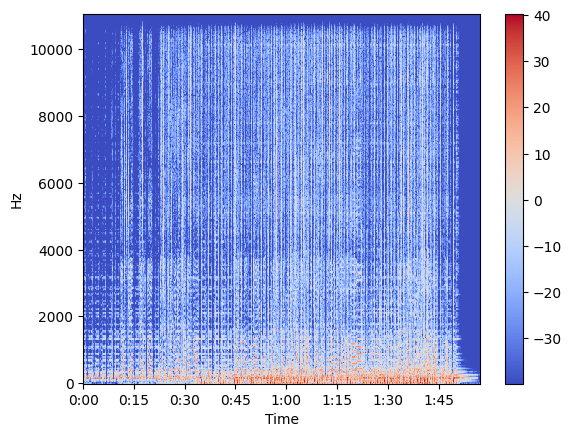

In [107]:
audio_stft_db = librosa.amplitude_to_db(np.abs(audio_stft))
librosa.display.specshow(audio_stft_db, sr=sr, x_axis="time", y_axis="hz")
plt.colorbar()
plt.show()

In [108]:
# Inverse STFT
audio_inv_stft = librosa.istft(
    (
        audio_stft[
            :511,
        ]
    ),
    n_fft=1024,
    hop_length=768,
)


In [109]:
Audio(audio_inv_stft, rate=sr)

In [110]:
stem = "vocal"
vocal_model = torch.load(f"./model/save/{stem}_best_model.pt", map_location=device)

In [111]:
# Function !!
total_frame = audio_stft.shape[1] // 127 + 1
done_frame = 0
vocal_model.eval()
for i in range(0, audio_stft.shape[1], 127):
    mixture = np.abs(audio_stft[:511, i : i + 127])
    col_num = mixture.shape[1]
    if col_num != 127:
        mixture = np.concatenate(
            (mixture, np.zeros(shape=(511, 127 - col_num))), axis=1
        )

    mixture = torch.from_numpy(mixture[np.newaxis, np.newaxis, :, :]).to(device)
    input = dataloader(mixture.to(torch.float32), batch_size=1)
    with torch.no_grad():
        for x in input:
            # print(x.shape)
            y = vocal_model(x)
            if i == 0:
                output = y[0][0]
            else:
                if col_num == 127:
                    output = torch.cat([output, y[0][0]], dim=1)
                else:
                    output = torch.cat([output, y[0][0][:, :col_num]], dim=1)
    done_frame += 1
    print(f"{done_frame}/{total_frame}")

1/40
2/40
3/40
4/40
5/40
6/40
7/40
8/40
9/40
10/40
11/40
12/40
13/40
14/40
15/40
16/40
17/40
18/40
19/40
20/40
21/40
22/40
23/40
24/40
25/40
26/40
27/40
28/40
29/40
30/40
31/40
32/40
33/40
34/40
35/40
36/40
37/40
38/40
39/40
40/40


In [112]:
output = (output.to(torch.device("cpu"))).numpy()
print(audio_stft[:511, :].shape)
print(output.shape)

(511, 5049)
(511, 5049)


In [113]:
output = np.multiply(audio_stft[:511, :], output)

audio_output = librosa.istft(output, n_fft=1024, hop_length=768)
Audio(audio_output, rate=sr)